In [4]:
#imports
%matplotlib inline

from PIL import Image
import urllib, cStringIO
import random

from astropy.io import fits as pyfits
from astropy.table import Table,join
import numpy as np
import os
from astropy.io.fits import Column
from datetime import datetime
from operator import itemgetter
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
plt.rcParams['text.usetex']=True

#function for getting galaxy images
def get_image_from_url(url):

    file = cStringIO.StringIO(urllib.urlopen(url).read())
    img = Image.open(file)
    return img

#table of galaxies - vote fractions and urls for getting images. 
data=Table.read('gzh_3_23_with_urls.fits')

#current threshold values:
cuts=Table.read('gzh_cuts.fits')
p_features_cut=cuts['p_features_cut'][0]
p_clumpy_no_cut=cuts['p_clumpy_no_cut'][0]
p_edgeon_no_cut = cuts['p_edgeon_no_cut'][0]

p_features = 't01_smooth_or_features_a02_features_or_disk_best_fraction' 
p_clumpy_no = 't12_clumpy_a02_no_weighted_fraction' 
p_edgeon_no = 't02_edgeon_a02_no_weighted_fraction' 


p_bar_yes = 't03_bar_a01_bar_weighted_fraction' 
N_bar = 't03_bar_total_weight' 


## Below: adjust p_bar_cut to obtain >95% pure sample of bars 

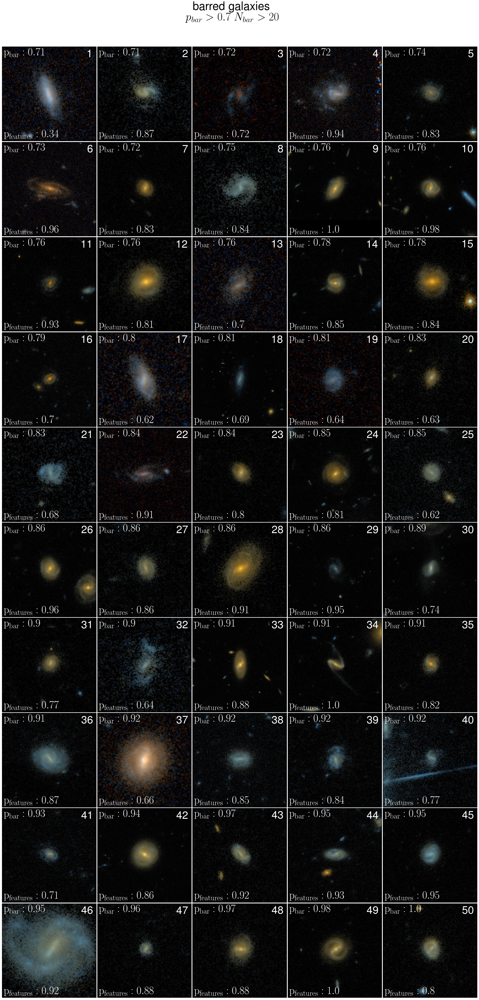

In [11]:
p_bar_pure_cut = .7

featured = (data[p_features]>p_features_cut)
not_clumpy = (data[p_clumpy_no]>p_clumpy_no_cut)
not_edge_on = (data[p_edgeon_no]>p_edgeon_no_cut)

pure_barred=(data[p_bar_yes]>p_bar_pure_cut)
min_N = data[N_bar]>20

gs=gridspec.GridSpec(10,5)
gs.update(wspace=0.01)
gs.update(hspace=0.01)
 
data_criteria= featured & not_clumpy & not_edge_on & pure_barred &min_N
these_data=data[data_criteria]

if len(these_data) < 20:
    print 'try new values'

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
random.seed(3)
random.shuffle(n_list)

labels = np.linspace(1,50,50)

#how many galaxies to display?
n_gals = 50
random_n_list = n_list[0:n_gals]

random_gal_list = []
for n in random_n_list:
    random_gal_list.append(these_data[int(n)])

#now we have a random list of galaxies - sort them by p_bar_yes, column 28
random_gal_list.sort(key=itemgetter(28))

f=plt.figure(figsize=(30,60))
n=0
for i in range (0,10):
    for j in range(0,5):
        ax=plt.subplot(gs[i,j])
        gal = random_gal_list[n] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('$\mathrm{p_{bar}: %s}$'%round(gal[p_bar_yes],2),fontsize=38,xy=(0.02,.97),
            xycoords='axes fraction',verticalalignment='top',color='white')

        ax.annotate('$\mathrm{p_{features}: %s}$'%round(gal[p_features],2),fontsize=38,xy=(0.02,.02),
            xycoords='axes fraction',color='white')
        
        ax.annotate('%s'%int(labels[n]),fontsize=38,xy=(0.97,0.97),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')


        n+=1
        

f.text(.5,.92,'barred galaxies \n$p_{bar}>%s$ $N_{bar}>20$'%(p_bar_pure_cut), fontsize=40,ha='center')





In [12]:
len(these_data)

730


## Galaxies in the pure sample that are:

barred (must be obvious bar): 

not barred / too weak to tell: 1, 4, 32

## These criteria generate 730 barred galaxies. 94% in a subsample of 50 were considered barred.


## Below: complete sample 

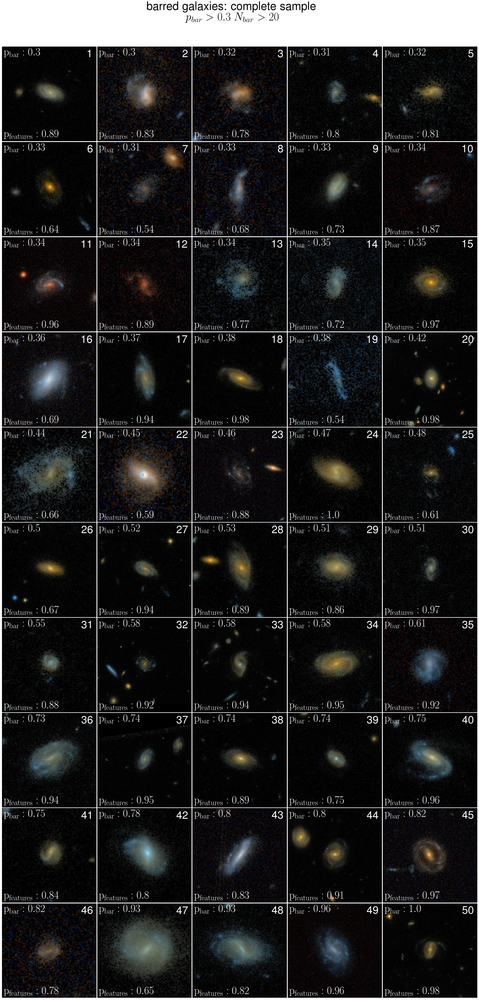

In [13]:
p_bar_complete_cut = .3

complete_bar = (data[p_bar_yes]>p_bar_complete_cut)

gs=gridspec.GridSpec(10,5)
gs.update(wspace=0.01)
gs.update(hspace=0.01)
 
data_criteria= featured & not_clumpy & not_edge_on & complete_bar &min_N
these_data=data[data_criteria]

if len(these_data) < 20:
    print 'try new values'

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
random.seed(3)
random.shuffle(n_list)

labels = np.linspace(1,50,50)

#how many galaxies to display?
n_gals = 50
random_n_list = n_list[0:n_gals]

random_gal_list = []
for n in random_n_list:
    random_gal_list.append(these_data[int(n)])

#now we have a random list of galaxies - sort them by p_bar_yes, column 28
random_gal_list.sort(key=itemgetter(28))

f=plt.figure(figsize=(30,60))
n=0
for i in range (0,10):
    for j in range(0,5):
        ax=plt.subplot(gs[i,j])
        gal = random_gal_list[n] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('$\mathrm{p_{bar}: %s}$'%round(gal[p_bar_yes],2),fontsize=38,xy=(0.02,.97),
            xycoords='axes fraction',verticalalignment='top',color='white')

        ax.annotate('$\mathrm{p_{features}: %s}$'%round(gal[p_features],2),fontsize=38,xy=(0.02,.02),
            xycoords='axes fraction',color='white')
        
        ax.annotate('%s'%int(labels[n]),fontsize=38,xy=(0.97,0.97),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')


        n+=1
        

f.text(.5,.92,'barred galaxies: complete sample \n$p_{bar}>%s$ $N_{bar}>20$'%(p_bar_complete_cut), fontsize=40,ha='center')





In [14]:
len(these_data)

3218

## Galaxies in the complete sample that are:

barred (including very weak bars): 

definitely not barred: 2, 3, 5, 7, 8, 9, 19

## These criteria generate 3,218 barred galaxies. 86% in a subsample of 50 were considered barred.



## Below: Galaxies that should not contain bars

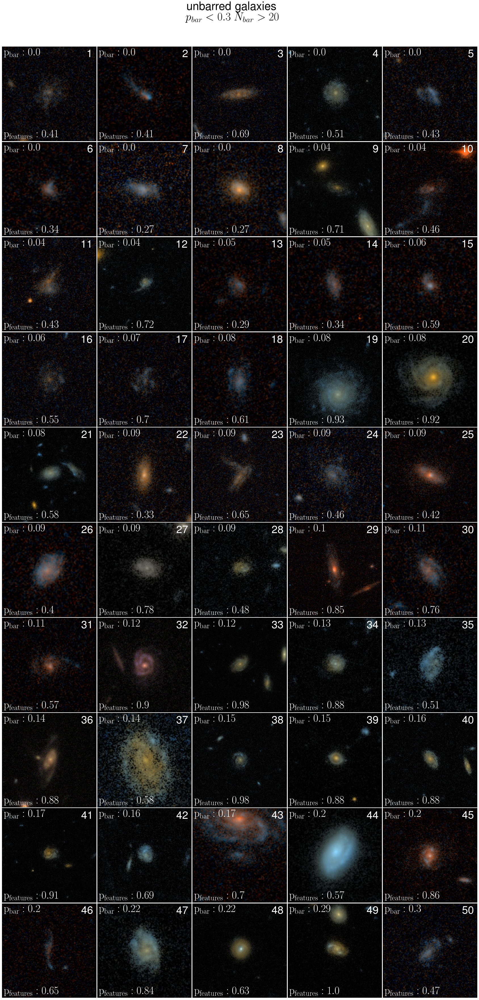

In [15]:
p_bar_complete_cut = .3

no_bar = (data[p_bar_yes]<p_bar_complete_cut)

gs=gridspec.GridSpec(10,5)
gs.update(wspace=0.01)
gs.update(hspace=0.01)
 
data_criteria= featured & not_clumpy & not_edge_on & no_bar & min_N
these_data=data[data_criteria]

if len(these_data) < 20:
    print 'try new values'

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
random.seed(3)
random.shuffle(n_list)

labels = np.linspace(1,50,50)

#how many galaxies to display?
n_gals = 50
random_n_list = n_list[0:n_gals]

random_gal_list = []
for n in random_n_list:
    random_gal_list.append(these_data[int(n)])

#now we have a random list of galaxies - sort them by p_bar_yes, column 28
random_gal_list.sort(key=itemgetter(28))

f=plt.figure(figsize=(30,60))
n=0
for i in range (0,10):
    for j in range(0,5):
        ax=plt.subplot(gs[i,j])
        gal = random_gal_list[n] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('$\mathrm{p_{bar}: %s}$'%round(gal[p_bar_yes],2),fontsize=38,xy=(0.02,.97),
            xycoords='axes fraction',verticalalignment='top',color='white')

        ax.annotate('$\mathrm{p_{features}: %s}$'%round(gal[p_features],2),fontsize=38,xy=(0.02,.02),
            xycoords='axes fraction',color='white')
        
        ax.annotate('%s'%int(labels[n]),fontsize=38,xy=(0.97,0.97),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')


        n+=1
        

f.text(.5,.92,'unbarred galaxies \n$p_{bar}<%s$ $N_{bar}>20$'%(p_bar_complete_cut), fontsize=40,ha='center')





In [16]:
len(these_data)

7816

## Galaxies in the unbarred sample that are:

barred (including very weak bars): none

definitely not barred: all

## These criteria generate 7,816 barred galaxies. 100% in a subsample of 50 were considered unbarred.



In [17]:
3218./7816

0.4117195496417605

## Using the complete sample of bars, we find a bar fraction of ~0.41.